In [16]:
# básicas

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import scipy.stats as stats
from datetime import datetime

# ML

from sklearn.model_selection import train_test_split



In [17]:
df_burnout = pd.read_csv("../data/train.csv")

In [18]:
df = df_burnout.dropna()
df

,Employee ID,Date of Joining,Gender,Company Type,WFH Setup Available,Designation,Resource Allocation,Mental Fatigue Score,Burn Rate
0,fffe32003000360033003200,2008-09-30,Female,Service,No,2.0,3.0,3.8,0.16
1,fffe3700360033003500,2008-11-30,Male,Service,Yes,1.0,2.0,5.0,0.36
3,fffe32003400380032003900,2008-11-03,Male,Service,Yes,1.0,1.0,2.6,0.20
4,fffe31003900340031003600,2008-07-24,Female,Service,No,3.0,7.0,6.9,0.52
5,fffe3300350037003500,2008-11-26,Male,Product,Yes,2.0,4.0,3.6,0.29
...,...,...,...,...,...,...,...,...,...
22743,fffe3300390030003600,2008-12-15,Female,Product,Yes,1.0,3.0,6.0,0.48
22744,fffe32003500370033003200,2008-05-27,Male,Product,No,3.0,7.0,6.2,0.54
22746,fffe33003000350031003800,2008-01-19,Female,Product,Yes,3.0,6.0,6.7,0.59
22748,fffe33003300320036003900,2008-01-10,Female,Service,No,2.0,5.0,5.9,0.52


In [19]:
df = df.rename(columns={
    'Employee ID': 'id',
    'Date of Joining': 'date',
    'Gender': 'gender',
    'Company Type': 'company',
    'WFH Setup Available': 'wfh',
    'Designation': 'position',
    'Resource Allocation': 'allocation',
    'Mental Fatigue Score': 'mentalfatige',
    'Burn Rate': 'burnout'
})

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18590 entries, 0 to 22749
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   id            18590 non-null  object 
 1   date          18590 non-null  object 
 2   gender        18590 non-null  object 
 3   company       18590 non-null  object 
 4   wfh           18590 non-null  object 
 5   position      18590 non-null  float64
 6   allocation    18590 non-null  float64
 7   mentalfatige  18590 non-null  float64
 8   burnout       18590 non-null  float64
dtypes: float64(4), object(5)
memory usage: 1.4+ MB


In [21]:
df['gender'] = df['gender'].replace({'Male': 1, 'Female': 0})
df['company'] = df['company'].replace({'Service': 1, 'Product' : 0})
df['wfh'] = df['wfh'].replace({'Yes' : 1, 'No' : 0})

C:\Users\maria\AppData\Local\Temp\ipykernel_11396\4236369812.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['gender'] = df['gender'].replace({'Male': 1, 'Female': 0})
C:\Users\maria\AppData\Local\Temp\ipykernel_11396\4236369812.py:2: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['company'] = df['company'].replace({'Service': 1, 'Product' : 0})
C:\Users\maria\AppData\Local\Temp\ipykernel_11396\4236369812.py:3: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retai

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18590 entries, 0 to 22749
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   id            18590 non-null  object 
 1   date          18590 non-null  object 
 2   gender        18590 non-null  int64  
 3   company       18590 non-null  int64  
 4   wfh           18590 non-null  int64  
 5   position      18590 non-null  float64
 6   allocation    18590 non-null  float64
 7   mentalfatige  18590 non-null  float64
 8   burnout       18590 non-null  float64
dtypes: float64(4), int64(3), object(2)
memory usage: 1.4+ MB


In [23]:
# Listar las columnas que quieres eliminar
delete = ['date', 'id', 'mentalfatige']

# Eliminar las columnas especificadas
df = df.drop(delete, axis=1)

In [24]:
X = df.drop('burnout', axis=1)  # características
y = df['burnout']  # variable target

# Dividir los datos en entrenamiento y prueba
# from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Mostrar las dimensiones de los conjuntos divididos
print("Tamaño del conjunto de entrenamiento (X_train):", X_train.shape)
print("Tamaño del conjunto de prueba (X_test):", X_test.shape)
print("Tamaño de las etiquetas de entrenamiento (y_train):", y_train.shape)
print("Tamaño de las etiquetas de prueba (y_test):", y_test.shape)

Tamaño del conjunto de entrenamiento (X_train): (14872, 5)
Tamaño del conjunto de prueba (X_test): (3718, 5)
Tamaño de las etiquetas de entrenamiento (y_train): (14872,)
Tamaño de las etiquetas de prueba (y_test): (3718,)


In [25]:
X_train

,gender,company,wfh,position,allocation
19000,1,0,1,2.0,6.0
19405,1,1,0,3.0,7.0
9965,0,0,0,2.0,3.0
613,0,0,0,3.0,6.0
3475,1,0,0,0.0,1.0
...,...,...,...,...,...
13864,0,1,0,3.0,5.0
14685,0,1,1,1.0,2.0
6570,1,0,0,1.0,2.0
1058,0,0,1,1.0,3.0


In [26]:
y_train

19000    0.71
19405    0.63
9965     0.48
613      0.32
3475     0.05
         ... 
13864    0.31
14685    0.23
6570     0.32
1058     0.27
19353    0.72
Name: burnout, Length: 14872, dtype: float64

In [27]:
X_test

,gender,company,wfh,position,allocation
8815,1,1,1,1.0,2.0
10896,1,1,1,2.0,4.0
16049,1,1,0,3.0,4.0
1746,0,1,1,2.0,4.0
5473,1,1,1,4.0,9.0
...,...,...,...,...,...
18911,1,0,1,2.0,5.0
15930,1,0,1,3.0,6.0
17999,0,1,1,3.0,5.0
12884,1,0,0,3.0,5.0


In [28]:
y_test

8815     0.18
10896    0.29
16049    0.36
1746     0.48
5473     0.79
         ... 
18911    0.41
15930    0.48
17999    0.49
12884    0.61
8694     0.46
Name: burnout, Length: 3718, dtype: float64

In [29]:
from sklearn.model_selection import GridSearchCV
from lightgbm import LGBMRegressor


In [30]:
param_grid = {
    'learning_rate': [0.05, 0.1, 0.2], # Tasa de aprendizaje que controla la contribución de cada árbol
    'n_estimators': [50, 100, 200], # Número de árboles en el modelo
    'max_depth': [3, 5, 7], # Profundidad máxima de cada árbol.
    'num_leaves': [5, 10, 20], # Número máximo de hojas en un árbol
    'min_child_samples': [10, 20, 30], # Número mínimo de muestras necesarias en cada hoja.
    'reg_alpha': [0.0, 0.1, 0.5], # Regularización L1 para controlar la complejidad del modelo.
    'reg_lambda': [0.0, 0.1, 0.5] # Regularización L2 para controlar la complejidad del modelo.
}

grid_search = GridSearchCV(estimator=LGBMRegressor(), param_grid=param_grid, scoring='neg_mean_squared_error', cv=5, verbose=1)
grid_search.fit(X_train, y_train)

print("Mejores hiperparámetros encontrados:")
print(grid_search.best_params_)


Fitting 5 folds for each of 2187 candidates, totalling 10935 fits
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000111 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 23
[LightGBM] [Info] Number of data points in the train set: 11897, number of used features: 5
[LightGBM] [Info] Start training from score 0.452762
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000130 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 23
[LightGBM] [Info] Number of data points in the train set: 11897, number of used features: 5
[LightGBM] [Info] Start training from score 0.452500
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_row_w

In [31]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Predecir sobre el conjunto de entreno
y_pred_train = grid_search.predict(X_train)

# Calcular métricas de evaluación
mae = mean_absolute_error(y_train, y_pred_train)
rmse = mean_squared_error(y_train, y_pred_train, squared=False)
r2 = r2_score(y_train, y_pred_train)

print(f"MAE: {mae}")
print(f"RMSE: {rmse}")
print(f"R^2: {r2}")

MAE: 0.0796380787781472
RMSE: 0.09892128850381408
R^2: 0.7511644390241203


c:\Users\maria\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [32]:
# Predecir sobre el conjunto de prueba
y_pred_test = grid_search.predict(X_test)

# Calcular métricas de evaluación
mae = mean_absolute_error(y_test, y_pred_test)
rmse = mean_squared_error(y_test, y_pred_test, squared=False)
r2 = r2_score(y_test, y_pred_test)


print(f"MAE: {mae}")
print(f"RMSE: {rmse}")
print(f"R^2: {r2}")



MAE: 0.07745991916997734
RMSE: 0.09635862479980019
R^2: 0.7582336618964819


c:\Users\maria\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [33]:
comparacion = pd.DataFrame({'real' : y_test, 'predicho' : y_pred_test})

comparacion['error'] = comparacion['real'] - comparacion['predicho']

comparacion['porcentaje'] = (comparacion['error'].abs()/comparacion['real'])*100

# print(comparacion)

comparacion['porcentaje'].sort_values(ascending=False)

comparacion.loc[22036]


real          0.000000
predicho      0.137177
error        -0.137177
porcentaje         inf
Name: 22036, dtype: float64

In [34]:
# Calcular el porcentaje de error, manejando el caso cuando 'real' es 0
def calcular_porcentaje_error(row):
    if row['real'] == 0:
        return 0
    else:
        return (abs(row['error'])) * 100

comparacion['porcentaje'] = comparacion.apply(calcular_porcentaje_error, axis=1)

# Ordenar por el porcentaje de error
comparacion_ordenada = comparacion['porcentaje'].sort_values(ascending=False)

# Imprimir la fila específica
print(comparacion.loc[14434])

# Imprimir las primeras filas del DataFrame ordenado
print(comparacion_ordenada)


real           0.030000
predicho       0.220503
error         -0.190503
porcentaje    19.050316
Name: 14434, dtype: float64
13560    34.336052
5335     34.145144
5679     31.120538
13659    30.918124
8144     30.565548
           ...    
4109      0.000000
3109      0.000000
12898     0.000000
13887     0.000000
12842     0.000000
Name: porcentaje, Length: 3718, dtype: float64


In [35]:
comparacion.head(5)

,real,predicho,error,porcentaje
8815,0.18,0.271008,-0.091008,9.100798
10896,0.29,0.411396,-0.121396,12.139563
16049,0.36,0.428292,-0.068292,6.829178
1746,0.48,0.392643,0.087357,8.735732
5473,0.79,0.804442,-0.014442,1.444250


C:\Users\maria\AppData\Local\Temp\ipykernel_11396\143374918.py:5: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(comparacion['real'], comparacion['predicho'], cmap='viridis')
C:\Users\maria\AppData\Local\Temp\ipykernel_11396\143374918.py:8: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cbar = plt.colorbar(plt.scatter(comparacion['real'], comparacion['predicho'], cmap='viridis'))


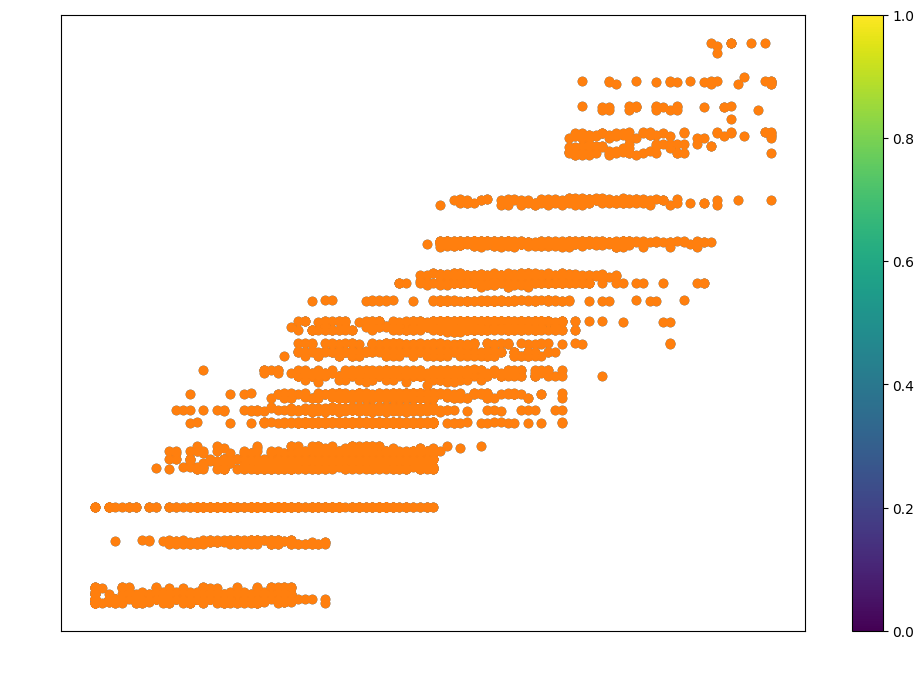

In [36]:
import matplotlib.pyplot as plt
import seaborn as sb

plt.figure(figsize=(12, 8))
plt.scatter(comparacion['real'], comparacion['predicho'], cmap='viridis')
plt.xlabel('Burnout', color = 'white')
plt.ylabel('Predicho', color='white')
cbar = plt.colorbar(plt.scatter(comparacion['real'], comparacion['predicho'], cmap='viridis'))
# Cambiar el color de los números del eje a blanco
plt.tick_params(axis='x', colors='white')
plt.tick_params(axis='y', colors='white')

In [38]:
import joblib

# Guardar el modelo optimizado
best_model = grid_search.best_estimator_
joblib.dump(best_model, 'lgbm_sin_mentalfatige.pkl')


print("Modelo guardado exitosamente")


Modelo guardado exitosamente


In [39]:
# Cargar el modelo y el scaler guardados
loaded_model = joblib.load('lgbm_sin_mentalfatige.pkl')


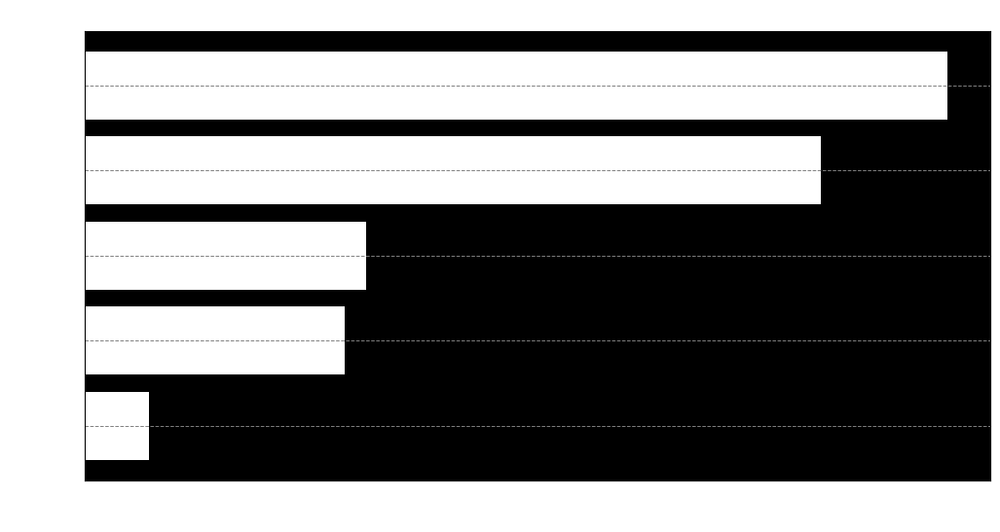

In [40]:
importances = loaded_model.feature_importances_
feature_names = ['gender', 'company', 'wfh', 'position', 'allocation', 'mentalfatige']

# Normalize the importances to sum to 100
importances_normalized = 100 * importances / np.sum(importances)

# Ordenar las características por su importancia
indices = np.argsort(importances_normalized)

# Ajustar el tema de Matplotlib para el fondo negro y letras blancas
plt.figure(figsize=(12, 6))
plt.gca().set_facecolor('black')
plt.grid(axis='y', color='gray', linestyle='--', linewidth=0.7)

# Crear el gráfico de barras
bars = plt.barh(range(len(indices)), importances_normalized[indices], align='center', color='white')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices], color='white')
plt.xlabel('Importancia relativa (%)', color='white')
plt.title('Importancia de las variables', color='white')

# Ajustar los ticks
plt.tick_params(axis='x', colors='white')
plt.tick_params(axis='y', colors='white')

# Mostrar el gráfico
plt.show()
